In [1]:
# Only run once!!
import os

os.chdir("../src/")

In [1]:
import os
import math
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import torch
from sklearn.preprocessing import PolynomialFeatures
import matplotlib.animation as animation
from IPython.display import HTML

# from sklearn.linear_model import LinearRegression
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel
from sklearn.linear_model import LinearRegression

from models import NNModel, LeastSquaresModel
from eval import read_run_dir, get_model_from_run
from tasks import Polynomials, PolynomialsFactorForm, FourierSeriesV2
from samplers import get_data_sampler
from tasks import get_task_sampler

%matplotlib notebook
%matplotlib inline
%load_ext autoreload
%autoreload 2

sns.set_theme("notebook", "darkgrid")
palette = sns.color_palette("colorblind")
mpl.rcParams["figure.dpi"] = 300

sns.set_theme("notebook", "darkgrid")
palette = sns.color_palette("colorblind")
mpl.rcParams["figure.dpi"] = 300
mpl.rcParams["text.usetex"] = True

mpl.rcParams.update(
    {
        "axes.titlesize": 12,
        "figure.titlesize": 10,  # was 10
        "legend.fontsize": 10,  # was 10
        "xtick.labelsize": 6,
        "ytick.labelsize": 6,
    }
)

run_dir = "../models"

In [2]:
SPINE_COLOR = "gray"


def format_axes(ax):
    for spine in ["top", "right"]:
        ax.spines[spine].set_color(SPINE_COLOR)
        ax.spines[spine].set_linewidth(0.5)

    for spine in ["left", "bottom"]:
        ax.spines[spine].set_color(SPINE_COLOR)
        ax.spines[spine].set_linewidth(0.5)

    ax.xaxis.set_ticks_position("bottom")
    ax.yaxis.set_ticks_position("left")

    for axis in [ax.xaxis, ax.yaxis]:
        axis.set_tick_params(direction="out", color=SPINE_COLOR)
    return ax

In [3]:
task = "fourier_series"

run_id_wo_curr = "final_model_wo_curr"  # without curriculum
run_id_w_curr = "final_model_w_curr"  # with curriculum
run_path_wo_curr = os.path.join(run_dir, task, run_id_wo_curr)
run_path_w_curr = os.path.join(run_dir, task, run_id_w_curr)


model_wo_curr, conf = get_model_from_run(run_path_wo_curr)
model_w_curr, _ = get_model_from_run(run_path_w_curr)

n_dims = conf.model.n_dims
batch_size = 1280  # conf.training.batch_size

data_sampler = get_data_sampler(conf.training.data, n_dims, **conf.training.data_kwargs)
task_sampler = get_task_sampler(
    conf.training.task, n_dims, batch_size, **conf.training.task_kwargs
)

In [4]:
torch.manual_seed(42)
task = task_sampler()
xs = data_sampler.sample_xs(
    b_size=batch_size, n_points=conf.training.curriculum.points.end
)
# xs = torch.tensor([list(np.linspace(-2, 2, 20).tolist()) for _ in range(batch_size)]).unsqueeze(-1)
ys = task.evaluate(xs)

In [5]:
class FourierFeatures:
    def __init__(self, max_freq, L):
        self.max_freq = max_freq
        self.L = L

    def transform(self, x):
        # Currently on supports 1-d features
        assert x.shape[-1] == 1
        batch_size = x.shape[0]
        #         sine_features = torch.sin((math.pi /(self.L)) * torch.arange(1, self.max_freq+1).unsqueeze(0) * x.view(-1, 1))\
        #             .view(batch_size, -1, self.max_freq)
        #         cosine_features = torch.cos((math.pi /(self.L)) * torch.arange(self.max_freq+1).unsqueeze(0) * x.view(-1, 1))\
        #             .view(batch_size, -1, self.max_freq + 1)

        cosine_features = (
            torch.cos(
                (math.pi / (self.L))
                * torch.arange(self.max_freq + 1).unsqueeze(0)
                * x.view(-1, 1)
            )
        ).view(batch_size, -1, self.max_freq + 1)
        sine_features = (
            torch.sin(
                (math.pi / (self.L))
                * torch.arange(1, self.max_freq + 1).unsqueeze(0)
                * x.view(-1, 1)
            )
        ).view(batch_size, -1, self.max_freq)
        return torch.cat([sine_features, cosine_features], dim=-1)

<Figure size 1920x1440 with 0 Axes>

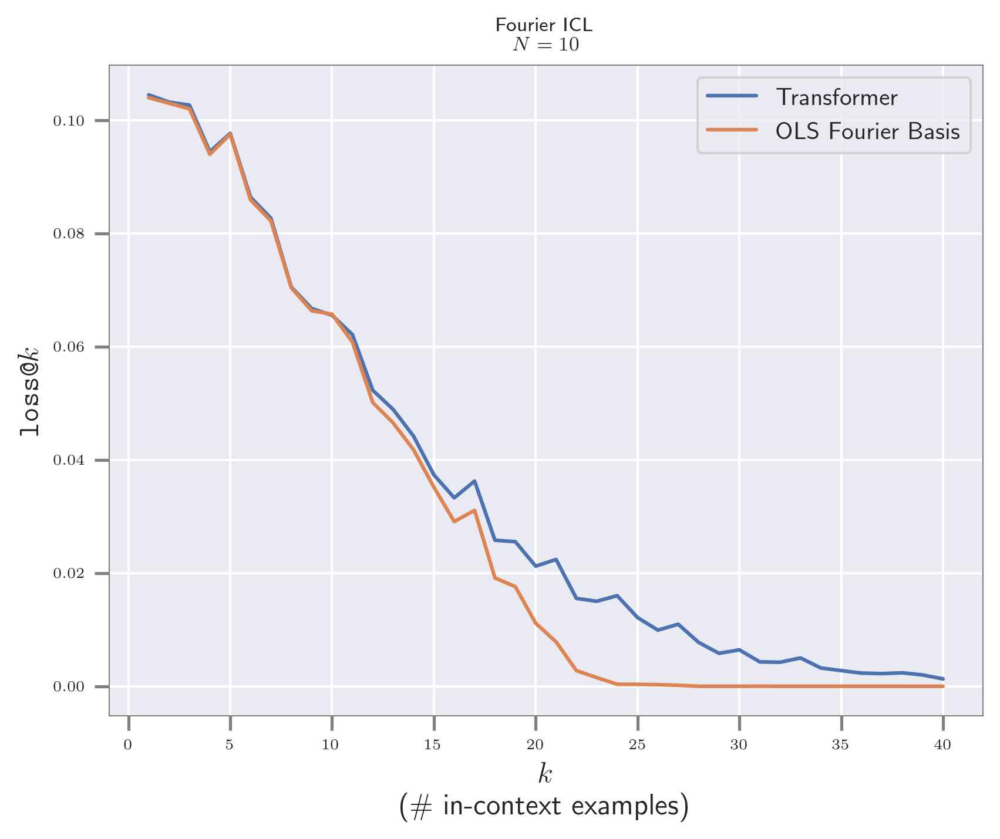

In [24]:
import warnings

warnings.filterwarnings("ignore")

batch_size = 1280
L = conf.training.task_kwargs["L"]
max_frequency = conf.training.task_kwargs["max_frequency"]
# for max_freq in range(1, 11):
#     task = PolynomialsFactorForm(1, batch_size, max_degree = degree, min_degree = degree,
#                       standardize = True, root_dist = "disjoint",
#                       x_dist="uniform", root_dist_kwargs = {"a": -5, "b": 5},
#                       dist_kwargs={"a": -5, "b": 5})

model_w_curr.to("cuda")

task = FourierSeriesV2(
    1, batch_size, max_frequency=max_frequency, standardize=True, L=L
)
xs = data_sampler.sample_xs(
    b_size=batch_size, n_points=conf.training.curriculum.points.end
)
ys = task.evaluate(xs)

# nn_model = NNModel(n_neighbors = 15, weights="non-uniform")
# nn_preds = nn_model(xs, ys)

fourier_fit_model = LeastSquaresModel()
fourier_fit_preds = fourier_fit_model(
    torch.Tensor(FourierFeatures(max_freq=max_frequency, L=L).transform(xs)), ys
)

with torch.no_grad():
    #     y_pred_wo_curr = model_wo_curr(xs, ys)
    y_pred_w_curr = model_w_curr(xs.to("cuda"), ys.to("cuda")).cpu()

# sq_errors_wo_curr = (ys - y_pred_wo_curr).square().mean(axis = 0)


sq_errors_w_curr = (ys - y_pred_w_curr).square().mean(axis=0)
# sq_nn_errors = (ys - nn_preds).square().mean(axis = 0)
sq_pf_errors = (ys - fourier_fit_preds).square().mean(axis=0)
#     sq_gpr_errors = (ys - gpr_preds).square().mean(axis = 0)
# plt.figure()
# fig, ax = plt.subplots()
# # ax.plot(np.arange(1, xs.shape[1]+1), sq_errors_wo_curr, label = "Transformer")
# ax.plot(np.arange(1, xs.shape[1]+1), sq_errors_w_curr, label = "Transformer")
# # ax.plot(np.arange(1, xs.shape[1]+1), sq_nn_errors, label = "Nearest Neighbors")
# ax.plot(np.arange(1, xs.shape[1]+1), sq_pf_errors, label = "OLS Fourier Basis")
# format_axes(ax)
# #     plt.plot(np.arange(1, xs.shape[1]+1), sq_gpr_errors, label = "GPR", marker = "o")
# plt.xlabel("$k$\n(\# in-context examples)")
# plt.ylabel("$\\texttt{loss@}k$")
# plt.title(f"Fourier ICL\n$N={max_frequency}$")
# # plt.yscale('log')
# plt.legend()

In [30]:
def get_df_from_pred_array(pred_arr, n_points, offset=0):
    # pred_arr --> b x pts-1
    batch_size = pred_arr.shape[0]
    flattened_arr = pred_arr.ravel()
    points = np.array(list(range(offset, n_points)) * batch_size)
    df = pd.DataFrame({"y": flattened_arr, "x": points})
    return df


def lineplot_with_ci(pred_or_err_arr, n_points, offset, label, ax, seed):
    sns.lineplot(
        data=get_df_from_pred_array(pred_or_err_arr, n_points=n_points, offset=offset),
        y="y",
        x="x",
        label=label,
        ax=ax,
        n_boot=1000,
        seed=seed,
        ci=90,
    )

In [36]:
metric = task.get_metric()
sq_errors_w_curr = metric(y_pred_w_curr, ys)
# sq_nn_errors = (ys - nn_preds).square().mean(axis = 0)
sq_pf_errors = metric(fourier_fit_preds, ys)

<Figure size 1920x1440 with 0 Axes>

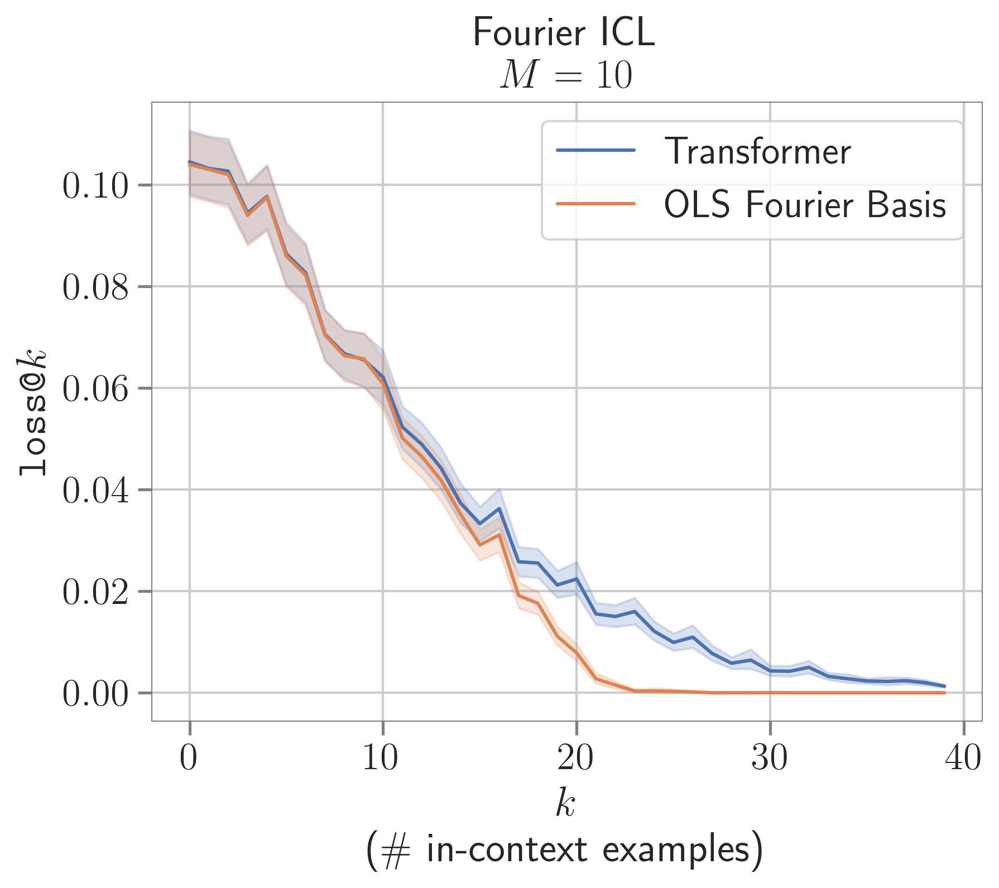

In [100]:
sns.set(style="whitegrid", font_scale=1.5)
seed = 42
plt.figure()
fig, ax = plt.subplots()
# ax.plot(np.arange(1, xs.shape[1]+1), sq_errors_wo_curr, label = "Transformer")
lineplot_with_ci(
    sq_errors_w_curr, xs.shape[1], offset=0, label="Transformer", ax=ax, seed=seed
)
# ax.plot(np.arange(1, xs.shape[1]+1), sq_nn_errors, label = "Nearest Neighbors")
lineplot_with_ci(
    sq_pf_errors, xs.shape[1], offset=0, label="OLS Fourier Basis", ax=ax, seed=seed
)
format_axes(ax)
#     plt.plot(np.arange(1, xs.shape[1]+1), sq_gpr_errors, label = "GPR", marker = "o")
plt.xlabel("$k$\n(\# in-context examples)")
plt.ylabel("$\\texttt{loss@}k$")
plt.title(f"Fourier ICL\n$M={max_frequency}$")
# plt.yscale('log')
plt.legend()
plt.savefig("final_plots/fourier_eq_errors.pdf", dpi=300, bbox_inches="tight")

## Function Visualizations

In [14]:
conf.training.task_kwargs

Munch({'L': 5, 'max_frequency': 10, 'standardize': True})

Getting Prefix Resuts


0it [00:00, ?it/s]

Predicting For Transformer
Predicting for Fourier OLS


2it [00:00, 11.53it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.49it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


6it [00:00, 11.40it/s]

Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.13it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 11.00it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


12it [00:01, 10.98it/s]
2it [00:00, 11.83it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.73it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.41it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 11.00it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


12it [00:01, 10.82it/s]

Predicting For Transformer
Predicting for Fourier OLS



2it [00:00, 11.73it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.88it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.63it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


10it [00:00, 11.32it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


12it [00:01, 11.29it/s]

Predicting for Fourier OLS



2it [00:00, 11.79it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.75it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


6it [00:01,  4.57it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


10it [00:01,  7.05it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


12it [00:01,  7.20it/s]


Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


2it [00:00, 11.62it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.14it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.13it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 10.85it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


12it [00:01, 10.85it/s]


Predicting For Transformer
Predicting for Fourier OLS


2it [00:00, 11.92it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.90it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.52it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 10.91it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


12it [00:01, 10.93it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS



2it [00:00, 12.10it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.88it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.51it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


10it [00:00, 11.16it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


12it [00:01, 11.21it/s]


Predicting for Fourier OLS


2it [00:00, 11.84it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.67it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.22it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 11.04it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


12it [00:01, 11.05it/s]


Predicting For Transformer
Predicting for Fourier OLS


2it [00:00, 12.10it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.89it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.47it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


10it [00:00, 11.19it/s]

Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


12it [00:01, 11.21it/s]


Predicting For Transformer
Predicting for Fourier OLS


2it [00:00, 11.34it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


4it [00:00, 11.39it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


8it [00:00, 11.43it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS


10it [00:00, 11.13it/s]

Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer
Predicting for Fourier OLS
Predicting For Transformer


12it [00:01, 11.08it/s]


Predicting for Fourier OLS


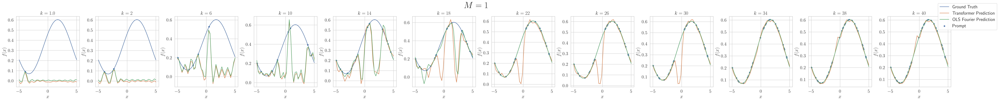

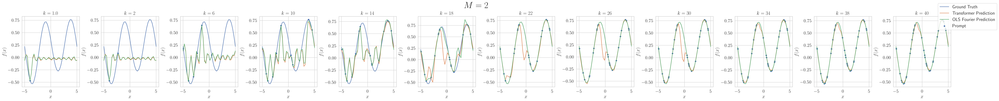

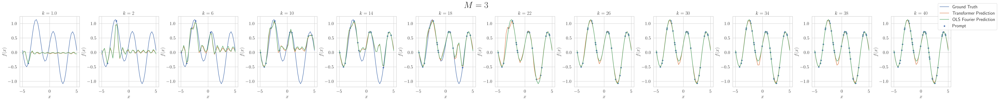

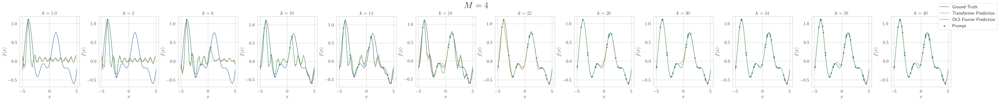

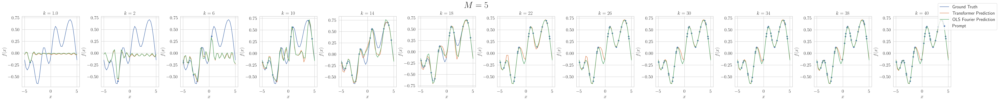

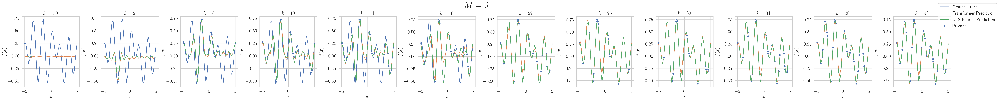

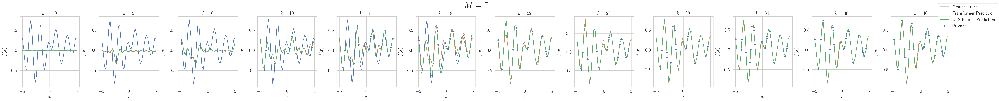

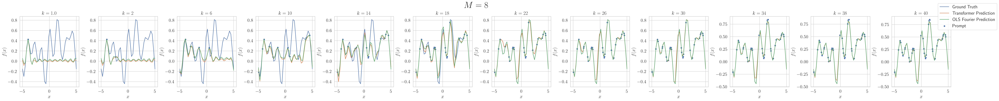

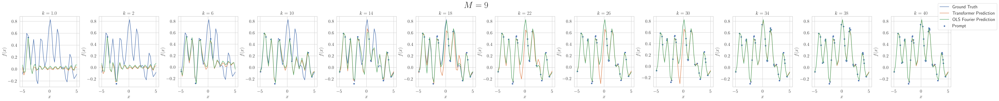

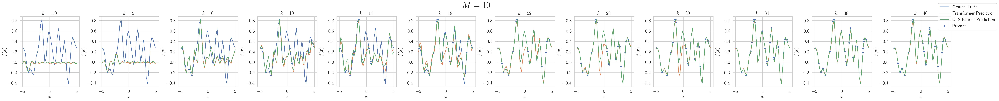

In [18]:
sns.set(style="whitegrid", font_scale=1.5)
model_w_curr.to("cuda")
save_dir = "final_plots/func_vis/"

if not os.path.exists(save_dir):
    os.makedirs(save_dir)

seed = 42

L = 5
prompt_len = 2
n = 40
batch_size = 1
min_freq = 1
max_freq = 10
xs = data_sampler.sample_xs(b_size=batch_size, n_points=n)
# task_sampler = get_task_sampler(
#         conf.training.task,
#         n_dims,
#         batch_size,
#         **conf.training.task_kwargs
#     )
# task = task_sampler()


y_preds = []
x_cont = torch.linspace(-L, L, n).unsqueeze(0).unsqueeze(-1)

y_preds_prefixes = []


print("Getting Prefix Resuts")
for max_freq in range(1, 11):
    torch.manual_seed(seed)
    task = FourierSeriesV2(
        1, 1, max_frequency=max_freq, min_frequency=min_freq, standardize=True, L=L
    )
    ys = task.evaluate(xs)
    y_cont = task.evaluate(x_cont)

    pls = [0.5] + list(range(1, 21, 2)) + [20]
    fig, axs = plt.subplots(
        1, len(pls), figsize=(4 * len(pls), 5), constrained_layout=True
    )

    for pl_idx, pl in tqdm(enumerate(pls)):
        x_prefix = xs[:, : int(2 * pl)]
        y_prefix = ys[:, : int(2 * pl)]

        x_prompt = torch.cat(
            [x_prefix.repeat(x_cont.size(1), 1, 1), x_cont.transpose(1, 0)], axis=1
        )
        y_prompt = torch.cat(
            [y_prefix.repeat(y_cont.size(1), 1), y_cont.transpose(1, 0)], axis=1
        )

        print("Predicting For Transformer")
        with torch.no_grad():
            if pl != 0:
                y_preds_trans = (
                    model_w_curr(x_prompt.to("cuda"), y_prompt.to("cuda"))
                    .squeeze()[:, -1]
                    .cpu()
                )
            else:
                y_preds_trans = (
                    model_w_curr(x_prompt.to("cuda"), y_prompt.to("cuda"))
                    .squeeze()
                    .cpu()
                )

        y_preds_trans = y_preds_trans.detach().cpu().numpy()

        print("Predicting for Fourier OLS")
        x_fourier_prefix = (
            FourierFeatures(max_freq=conf.training.task_kwargs["max_frequency"], L=L)
            .transform(x_prefix)
            .squeeze(0)
            .numpy()
        )
        x_fourier_cont = (
            FourierFeatures(max_freq=conf.training.task_kwargs["max_frequency"], L=L)
            .transform(x_cont)
            .squeeze(0)
            .numpy()
        )
        lsq_model = LinearRegression(fit_intercept=False)
        lsq_model.fit(x_fourier_prefix, y_prefix.numpy().squeeze(0))
        y_preds_fols = lsq_model.predict(x_fourier_cont)

        sns.lineplot(
            x=x_cont.squeeze(), y=y_cont.squeeze(), label="Ground Truth", ax=axs[pl_idx]
        )
        sns.lineplot(
            x=x_cont.squeeze(),
            y=y_preds_trans,
            label="Transformer Prediction",
            ax=axs[pl_idx],
        )
        sns.lineplot(
            x=x_cont.squeeze(),
            y=y_preds_fols,
            label="OLS Fourier Prediction",
            ax=axs[pl_idx],
        )
        sns.scatterplot(
            x=x_prefix.squeeze(0).squeeze(-1),
            y=y_prefix.squeeze(0),
            label="Prompt",
            ax=axs[pl_idx],
        )
        axs[pl_idx].set_title(f"$k = {2*pl}$")
        axs[pl_idx].set_xlabel(f"$x$")
        axs[pl_idx].set_ylabel(f"$f(x)$")

    for ax in axs:
        ax.legend().set_visible(False)

    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc="upper right", bbox_to_anchor=(1.05, 1))
    plt.suptitle(f"$M = {max_freq}$", fontsize=32)
    plt.savefig(
        f"{save_dir}/fourier_eq_func_vis_all_M{max_freq}.pdf",
        dpi=300,
        bbox_inches="tight",
    )

## Inductive Biases

Getting Prefix Resuts
Getting Prefix Resuts


0it [00:00, ?it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 60.51it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 541.82it/s]
1it [00:00,  2.66it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 60.44it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 520.75it/s]
2it [00:00,  2.66it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 55.48it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 78.25it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 579.25it/s]
2it [00:00,  3.08it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 61.15it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 548.09it/s]
3it [00:01,  2.93it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 60.38it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 649.99it/s]
3it [00:00,  3.16it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 70.60it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 618.60it/s]
4it [00:01,  3.12it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 75.27it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 614.38it/s]
5it [00:01,  3.15it/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████

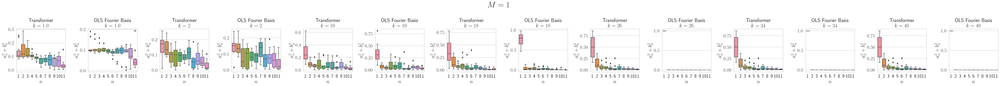

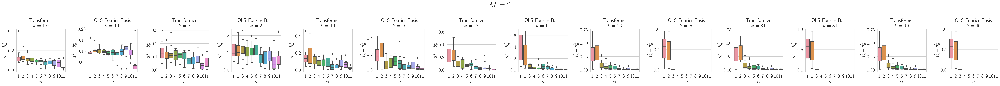

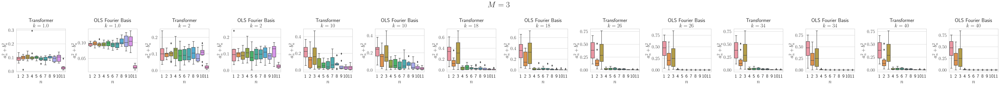

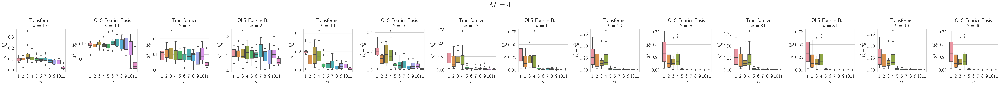

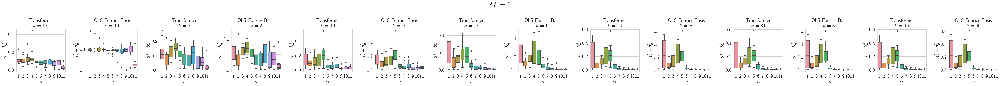

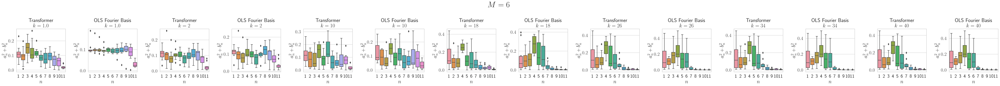

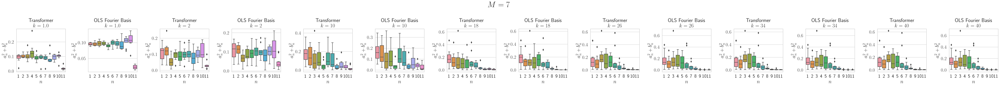

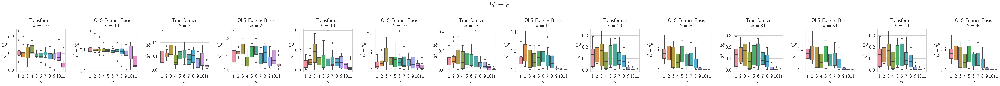

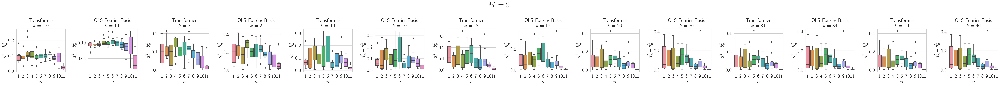

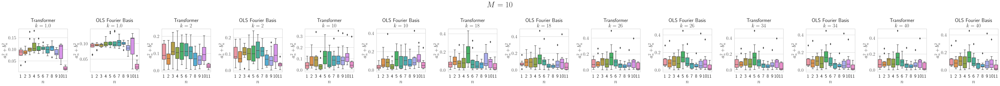

In [23]:
sns.set(style="whitegrid", font_scale=1.75)
model_w_curr.to("cuda")
save_dir = "final_plots/inductive_bias/"

if not os.path.exists(save_dir):
    os.makedirs(save_dir)

seed = 42

torch.manual_seed(seed)
L = 5
prompt_len = 2
n = 24
batch_size = 1
min_freq = 1
max_freq = 4
xs = data_sampler.sample_xs(b_size=batch_size, n_points=n)
task_sampler = get_task_sampler(
    conf.training.task, n_dims, batch_size, **conf.training.task_kwargs
)
task = task_sampler()
ys = task.evaluate(xs)

y_preds = []
x_cont = torch.linspace(-L, L, n).unsqueeze(0).unsqueeze(-1)
y_cont = task.evaluate(x_cont)

y_preds_prefixes = []
print("Getting Prefix Resuts")

print("Getting Prefix Resuts")
for max_freq in range(1, 11):
    torch.manual_seed(seed)
    task = FourierSeriesV2(
        1, 1, max_frequency=max_freq, min_frequency=min_freq, standardize=True, L=L
    )
    ys = task.evaluate(xs)
    y_cont = task.evaluate(x_cont)

    pls = [0.5] + list(range(1, 21, 4)) + [20]
    fig, axs = plt.subplots(
        1, 2 * len(pls), figsize=(4 * 2 * len(pls), 5), constrained_layout=True
    )

    for pl_idx, pl in tqdm(enumerate(pls)):
        for m_idx, model_type in enumerate(["Transformer", "OLS Fourier Basis"]):
            freq_dist = []
            seed_ls = []
            freqs_ls = []
            for seed in tqdm([1, 11, 22, 33, 44, 55, 66, 77, 88, 99]):
                torch.manual_seed(seed)
                task = FourierSeriesV2(
                    1,
                    1,
                    max_frequency=max_freq,
                    min_frequency=min_freq,
                    standardize=True,
                    L=L,
                )
                xs = data_sampler.sample_xs(b_size=1, n_points=n)
                ys = task.evaluate(xs)
                y_cont = task.evaluate(x_cont)

                x_prefix = xs[:, : int(2 * pl)]
                y_prefix = ys[:, : int(2 * pl)]

                y_preds = []

                x_prompt = torch.cat(
                    [x_prefix.repeat(x_cont.size(1), 1, 1), x_cont.transpose(1, 0)],
                    axis=1,
                )
                y_prompt = torch.cat(
                    [y_prefix.repeat(y_cont.size(1), 1), y_cont.transpose(1, 0)], axis=1
                )

                if "Transformer" in model_type:
                    with torch.no_grad():
                        if pl != 0:
                            y_preds = (
                                model_w_curr(x_prompt.to("cuda"), y_prompt.to("cuda"))
                                .squeeze()[:, -1]
                                .cpu()
                            )
                        else:
                            y_preds = (
                                model_w_curr(x_prompt.to("cuda"), y_prompt.to("cuda"))
                                .squeeze()
                                .cpu()
                            )

                    y_preds = y_preds.detach().cpu().numpy()

                elif model_type == "OLS Fourier Basis":
                    lsq_model = LinearRegression(fit_intercept=False)
                    x_fourier_prefix = (
                        FourierFeatures(
                            max_freq=conf.training.task_kwargs["max_frequency"], L=L
                        )
                        .transform(x_prefix)
                        .squeeze(0)
                        .numpy()
                    )
                    x_fourier_cont = (
                        FourierFeatures(
                            max_freq=conf.training.task_kwargs["max_frequency"], L=L
                        )
                        .transform(x_cont)
                        .squeeze(0)
                        .numpy()
                    )
                    lsq_model.fit(x_fourier_prefix, y_prefix.numpy().squeeze(0))
                    y_preds = lsq_model.predict(x_fourier_cont)

                y_fourier = y_preds.squeeze()
                ft = np.fft.fft(y_fourier)
                ft_shifted = np.fft.fftshift(ft)
                ft_normalized = ft_shifted / len(y_fourier)
                ft_positive = ft_normalized[1 + len(y_fourier) // 2 :]
                a_coefs = ft_positive.real
                b_coefs = ft_positive.imag
                coefs_normalized = (a_coefs**2 + b_coefs**2) / (
                    (a_coefs**2).sum() + (b_coefs**2).sum()
                )

                freq_coefs = coefs_normalized  # np.maximum(a_coefs, b_coefs)
                freq_dist += freq_coefs.tolist()
                seed_ls += [seed for _ in range(len(freq_coefs))]
                freqs_ls += list(range(1, len(freq_coefs) + 1))

            freq_dist_df = pd.DataFrame(
                {"Seed": seed_ls, "Frequency": freqs_ls, "Coefficient": freq_dist}
            )
            freq_dist_df = freq_dist_df.dropna()
            sns.boxplot(
                data=freq_dist_df,
                x="Frequency",
                y="Coefficient",
                ax=axs[2 * pl_idx + m_idx],
            )
            axs[2 * pl_idx + m_idx].set_title(f"{model_type}\n$k = {2*pl}$")
            axs[2 * pl_idx + m_idx].set_xlabel("$n$")
            axs[2 * pl_idx + m_idx].set_ylabel("$a_n^2 + b_n^2$")

    plt.suptitle(f"$M = {max_freq}$", fontsize=32)
    fig.tight_layout()
    plt.savefig(
        f"{save_dir}/fourier_eq_ib_M{max_freq}.pdf", dpi=300, bbox_inches="tight"
    )